# Data Generation with Mitsuba

Based on **Benedikt Bitterli's Rendering resources** (https://benedikt-bitterli.me/resources/) and (https://mitsuba.readthedocs.io/en/stable/src/gallery.html=) 32 different 3D scenes have been rendered with Mitsuba 3.

The generated data consists of histograms of radiance per pixel collected over several iterations of monte carlo ray tracing with 1 spp.

In [1]:
!pip install mitsuba==3.6.4 drjit==1.0.5 numpy matplotlib scikit-learn

In [2]:
# Data Processing + Utils
import random
import zipfile
import tifffile
import tempfile
import numpy as np
from tqdm import tqdm
from pathlib import Path
from sklearn.model_selection import train_test_split

# Mitsuba Renderer
import drjit as dr
import mitsuba as mi
from mitsuba import set_variant
mi.set_variant("scalar_rgb")
# "cuda_ad_rgb" for GPU or "llvm_ad_rgb" and "scalar_rgb" (default) for CPU

# Image Processing and Visialisation
from skimage.transform import resize
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

In [3]:
print(f"""
Library Version Sanity Check
Mitsuba:     {mi.__version__} (Expected: 3.6.4)
DRJIT:       {dr.__version__} (Expected: 1.0.5)
""")


Library Version Sanity Check
Mitsuba:     3.6.4 (Expected: 3.6.4)
DRJIT:       1.0.5 (Expected: 1.0.5)



In [4]:
# from google.colab import drive
# drive.mount('/content/drive')

## Configuration

In [5]:
NUM_BINS = 2        # 32
RANGE_VAL = 2       # 10

LOW_SPP = 5         # 74
HIGH_SPP = 10       # 1000

# resolution 
# Tested for 512
WIDTH = 512         # 1000
HEIGHT = 512        # 700

TEST_SPLIT = 0.2

LOG_BIN = False
DEBUG = False

input_path = "data"
output_path = "output"
SCENE_ROOT = Path(input_path)
OUTPUT_DIR = Path(output_path)
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)

## Data Loaders

**Data Loaders** from **zip** and **dir**

In [6]:
def extract_scene_zip(zip_path):
    """
    Extracts a zip file to a temporary directory

    Parameters:
    - zip_path (str): path to the zip file

    Returns:
    - temp_dir (str): path to the extracted directory
    """
    temp_dir = tempfile.mkdtemp()
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(temp_dir)
    return temp_dir

In [7]:
def load_scene_xml(scene_dir):
    """
    Loads a scene from .xml file with Mitsuba

    Parameters:
    - scene_dir (str): folder containing files of a scene

    Returns:
    - scene (Mitsuba Scene)
    """
    scene_dir = Path(scene_dir)
    xml_files = [
        f for f in scene_dir.rglob("*.xml")                           # recursive search
        if not f.name.startswith("._") and "__MACOSX" not in str(f)   # filter out metadata files on Mac
    ]

    if not xml_files:
        raise FileNotFoundError(f"No valid XML scene found in {scene_dir}")

    return mi.load_file(str(xml_files[0]))

# Load Data
- Single scene for testing
- Train/test datasets

In [8]:
# SINGLE IMAGE
one_scene = ["data/banner_01"]

# ALL IMAGES
all_scenes = sorted([d for d in SCENE_ROOT.iterdir() if d.is_dir()])
random.shuffle(all_scenes)
train_scenes, test_scenes = train_test_split(all_scenes, test_size=TEST_SPLIT, random_state=42)

print("Train Scenes: ", len(train_scenes))
print("Test Scenes; ", len(test_scenes))

Train Scenes:  21
Test Scenes;  6


# RAY - RADIANCE SAMPLING STRATEGY

In [9]:
def generate_samples_from_scene(scene, seed, spp=1, debug=DEBUG):
    """
    Generate radiance samples from a scene patch using full-image rendering.

    Parameters:
    - scene (Mitsuba scene): scene to render
    - seed (int): random seed
    - debug (bool): whether to print debug info

    Returns:
    - radiance_samples (ndarray): shape (height, width, 3)
    """
    # central pixel
    x, y = WIDTH // 2, HEIGHT // 2

    old_sensor = scene.sensors()[0]
    params = mi.traverse(old_sensor)

    # new integrator and sensor for independent sampling
    new_integrator = mi.load_dict({'type': 'path'})
    new_sensor = mi.load_dict({
        'type': "perspective",
        'fov': params['x_fov'],
        'near_clip': old_sensor.near_clip(),
        'far_clip': old_sensor.far_clip(),
        'to_world': old_sensor.world_transform(),
        'sampler': {
            'type': 'independent',
            'sample_count': 1
        },
        'film': {
        'type': 'hdrfilm',
        'width': WIDTH,
        'height': HEIGHT,
        'rfilter': {'type': 'box'},
        'pixel_format': 'rgb',
        'component_format': 'float32'
        }
    })

    # Render the full image with 1 sample per pixel
    image = mi.render(scene, spp=spp, sensor=new_sensor, integrator=new_integrator, seed=seed)

    if debug:
      print("Image Shape: ", image.shape)
      print("RGB: ", image[x, y, :])

    return image  # Shape: (height, width, 3)

## HELPER FUNCTIONS

- **Estimate Range**:
- **Accumulate Histogram**:


In [10]:
def estimate_range(initial_samples, use_log=LOG_BIN):
    """
    Estimates binning range based on initial radiance samples.
    Uses either log-based or percentile-based linear binning.

    Parameters:
    - initial_samples (np array): radiance samples (RANGE_VAL * 3 for RGB)
    - use_log (bool): whether to use log-based range estimation

    Returns:
    - min_val (float): minimum bin value
    - max_val (float): maximum bin value
    """
    if len(initial_samples) == 0:
        min_val, max_val = 1e-8, 1.0
    else:
        # Filter out zero or near-zero values
        positive_samples = initial_samples[initial_samples > 1e-8]

        if len(positive_samples) == 0:
            min_val, max_val = 1e-8, 1.0
        else:
            if use_log:
                min_val = np.min(positive_samples)
                max_val = np.max(positive_samples)
                if min_val == max_val:
                    max_val *= 2  # Prevent zero range
            else:
                # Use 1st and 99th percentiles for linear binning
                min_val = np.percentile(positive_samples, 1)
                max_val = np.percentile(positive_samples, 99)
                if min_val == max_val:
                    max_val *= 1.1  # Slightly increase to create range

    print(f"{'Log' if use_log else 'Linear'} estimated radiance range: [{min_val:.4e}, {max_val:.4e}]")
    return min_val, max_val

In [11]:
def accumulate_histogram(hist, samples, bin_edges, num_bins):
    """
    Vectorized histogram accumulation for batched radiance samples.

    Parameters:
    - hist: np.ndarray of shape (H, W, 3, B+1)
    - samples: np.ndarray of shape (H, W, N, 3) where N = number of images
    - bin_edges: np.ndarray of shape (B,)
    - num_bins: int, number of bins

    Returns:
    - zero_count: int, number of zero-radiance samples
    """
    H, W, N, C = samples.shape
    zero_count = 0

    for c in range(C):  # R, G, B
        # Extract all values for one channel, shape (H, W, N)
        channel_data = samples[:, :, :, c]

        # Flatten everything to (H * W * N,)
        flat = channel_data.reshape(-1)
        nonzero_mask = flat > 0.0

        # Bin assignment for non-zero values
        bins = np.searchsorted(bin_edges, flat[nonzero_mask], side='right')
        bins = np.clip(bins, 1, num_bins)

        # Get pixel positions from flattened indices
        indices = np.flatnonzero(nonzero_mask)
        ys, xs, ns = np.unravel_index(indices, (H, W, N))

        # Accumulate non-zero values
        np.add.at(hist[:, :, c], (ys, xs, bins), 1)

        # Zero values
        zero_mask = ~nonzero_mask
        zero_indices = np.flatnonzero(zero_mask)
        ys0, xs0, _ = np.unravel_index(zero_indices, (H, W, N))
        np.add.at(hist[:, :, c, 0], (ys0, xs0), 1)

        zero_count += zero_mask.sum()

    return zero_count

In [12]:
def compute_bin_edges(min_val, max_val, num_bins, use_log=LOG_BIN):
    """
    Computes bin edges for histogram (linear or logarithmic binning)

    Parameters:
    - min_val (float): minimum value in the data
    - max_val (float): maximum value in the data
    - num_bins (int): number of bins (excluding zero bin)
    - use_log (bool): whether to use logarithmic spacing

    Returns:
    - bin_edges (np.ndarray): array of bin edges (length = num_bins)
    """
    if use_log:
        log_min = np.log10(min_val)
        log_max = np.log10(max_val)
        bin_edges = np.logspace(log_min, log_max, num_bins)
    else:
        bin_edges = np.linspace(min_val, max_val, num_bins)
    return bin_edges

In [13]:
def generate_histograms(scene, low_spp, num_bins):
    """
    Generate radiance histograms over full image using wavefront rendering.

    Returns:
    - histograms (H, W, 3, B+1)
    - bin_edges (B,)
    """
    print("Range Val:", RANGE_VAL)
    print("SPP:", low_spp)
    print("Total Pixels:", WIDTH * HEIGHT)

    zero_count_total = 0
    initial_samples_list = []

    for s in range(RANGE_VAL):
        print(f"Iteration {s} <3")
        seed = 42 + s
        radiance_samples = generate_samples_from_scene(scene, seed, debug=DEBUG)
        initial_samples_list.append(radiance_samples)

    initial_samples = np.stack(initial_samples_list, axis=2)  # (H, W, RANGE_VAL, 3)
    reshaped = initial_samples.reshape(-1, 3)
    combined = np.concatenate([reshaped[:, 0], reshaped[:, 1], reshaped[:, 2]])
    min_val, max_val = estimate_range(combined)

    bin_edges = compute_bin_edges(min_val, max_val, num_bins, use_log=LOG_BIN)

    histograms = np.zeros((HEIGHT, WIDTH, 3, num_bins + 1), dtype=np.int32)

    additional_samples = []

    for s in range(RANGE_VAL, low_spp):
        print(f"Iteration {s} :)")
        seed = 1000 + s
        radiance_samples = generate_samples_from_scene(scene, seed, debug=DEBUG)
        additional_samples.append(radiance_samples)
    print("Image Samples Shape:", additional_samples[0].shape)

    # Stack shape: (H, W, low_spp - RANGE_VAL, 3)
    stacked_samples = np.stack(additional_samples, axis=2)
    print("Stacked Samples Shape:", stacked_samples.shape)

    # Now accumulate all at once
    print(f"Accumulating Histogram >.<")
    zero_count_total = accumulate_histogram(histograms, stacked_samples, bin_edges, num_bins)

    total_samples = HEIGHT * WIDTH * (low_spp - RANGE_VAL)
    print(f"Zero samples: {zero_count_total}/{total_samples} "
          f"({100 * zero_count_total / total_samples:.2f}%)")

    return histograms, np.concatenate(([0], bin_edges))

# Scene Processing Pipeline

1. **INPUT:** a list of paths to _zip_ files containing _xml_ scenes (and corresponding _obj_ files) to be rendered with Mitsuba 3

2. Extract info from _zip_ file and then load from _xml_

3. Get MCRT components:
- **sensor**: the camera --> determines direction, film resolution, lens settings
- **film**: collects and stores image data from scene --> defines resolution (width, height) of image
- **integrator**: controls how light is traced through the scene --> path tracing
- **sampler**: controls how samples are generated --> independent, 1 sample

4. Compute **Histograms** --> see explanation below!

5. Get edges and centers of the bins
- **bin edges**: currently generated by log-binning
- **bin centers**: midpoint between bin edges --> mean radiance per bin

6. **Visualisation**
- **NOISY vs. CLEAN** --> generate clean image with HIGH_SPP and plot it agains noisy image, i.e. average image computed as the average of the histogram per pixel generated with LOW_SPP
- **Histogram at Pixel** --> plot RGB histigram at pixel (x,y)

7. **OUTPUT:** radiance histograms per pixel of shape (N, H, W, C, B) where
- N: number of scenes
- H, W: image resolution
- C: channels --> currently 3 because RGB but can be extended to also include AOV such as normal, albedo, depth (not stochastic but give info about the scene)
- B: bins --> counts of radiance per bin

In [14]:
def get_average_image(histograms, bin_centers, height=HEIGHT, width=WIDTH):
    """
    Compute average per-pixel radiance from histograms.

    Parameters:
    - histograms (np.ndarray): shape (H, W, 3, B+1), includes zero bin
    - height (int): image height
    - width (int): image width
    - bin_centers (np.ndarray): bin centers including 0.0 as first value, shape (B+1,)

    Returns:
    - hist_avg (np.ndarray): shape (H, W, 3), average RGB per pixel
    """
    hist_avg = np.zeros((height, width, 3), dtype=np.float32)

    for c in range(3):  # RGB
        for py in range(height):
            for px in range(width):
                hist = histograms[py, px, c]  # (B+1,)
                total = hist.sum()
                if total > 0:
                    hist_avg[py, px, c] = np.sum(hist * bin_centers) / total
                else:
                    hist_avg[py, px, c] = 0.0

    print("Average Histogram Shape: ", hist_avg.shape)
    return hist_avg

In [15]:
def plot_images(clean_image, noisy_image):
  """
  NOISY vs. CLEAN Visualisation

  Parameters:
  - clean_image (np array): clean image of shape (H, W, C)
  - noisy_image (np array): noisy image of shape (H, W, C) = average from histograms
  """
  print("Clean Image: ", clean_image.shape)
  print("Average from Histogram: ", noisy_image.shape)

  plt.figure(figsize=(12,5))

  # CLEAN IMAGE
  plt.subplot(1,2,1)
  plt.title("Clean Scene")
  plt.imshow(np.clip(clean_image, 0, 1))
  plt.axis('off')

  # AGERAGE FROM HISTOGRAM
  plt.subplot(1,2,2)
  plt.title("Histogram Avg Patch (Low spp)")
  plt.imshow(np.clip(noisy_image, 0, 1))
  plt.axis('off')

  plt.tight_layout()
  plt.show()

In [16]:
def plot_rgb_histograms(histograms, px, py, bin_edges, use_log=LOG_BIN):
    """
    Plot RGB histograms of a single pixel

    Parameters:
    - histograms (np array): radiance histograms of shape (H, W, 3, B)
    - px (int): x coordinate of the pixel
    - py (int): y coordinate of the pixel
    - bin_centers (np array): bin centers of the histogram
    """
    color_labels = ['Red', 'Green', 'Blue']
    colors = ['r', 'g', 'b']

    plt.figure(figsize=(10, 6))
    for c in range(3):  # R, G, B
        hist = histograms[py, px, c]
        plt.plot(bin_edges, hist, color=colors[c], label=color_labels[c])

    plt.xlabel('Radiance (bin center)')
    plt.ylabel('Frequency')
    plt.title(f'Histogram at Pixel ({px}, {py})')
    if use_log:
        plt.xscale('log')  # if bin_edges are log-scaled !!!
    plt.legend()
    plt.grid(True, which="both", ls="--", lw=0.5)
    plt.tight_layout()
    plt.show()

In [26]:
def scene_processing_pipeline(scene_dirs, low_spp=LOW_SPP, high_spp=HIGH_SPP, num_bins=NUM_BINS, gen_clean=True, plot_hist=False):
    """
    Process scenes with multiple camera XML variants per scene directory

    Args:
        root_folder (str or Path): Root folder containing multiple scene directories
    """
    all_histograms = []
    image_count = 0

    for scene_dir in tqdm(scene_dirs):
        scene_dir = Path(scene_dir)
        image_count += 1
        print(f"\nProcessing scene {image_count} of {len(scene_dirs)}: {scene_dir}")
        
        # Find all XML files in the scene directory (camera variants)
        xml_files = list(scene_dir.rglob("*.xml"))
        xml_files = [f for f in xml_files if not f.name.startswith("._") and "__MACOSX" not in str(f)]
        
        if not xml_files:
            print(f"No XML files found in {scene_dir}")
            continue
        
        for xml_path in xml_files:
            cam_name = xml_path.stem  # filename without extension, use as camera/view name
            print(f"\n--- Camera/View: {cam_name} ---")
            
            # Load scene from XML file path
            scene = mi.load_file(str(xml_path))
            
            # Generate histograms
            histograms, bin_edges = generate_histograms(scene, low_spp, num_bins)
            all_histograms.append(histograms)
            
            if gen_clean:
                print("Rendering clean reference...")
                avg_img = get_average_image(histograms, bin_edges, HEIGHT, WIDTH)
                clean_img = generate_samples_from_scene(scene, seed=42, spp=high_spp)
                plot_images(clean_img, avg_img)
            
            if plot_hist:
                x, y =  WIDTH // 2, HEIGHT // 2
                plot_rgb_histograms(histograms, px=x, py=y, bin_edges=bin_edges, use_log=LOG_BIN)

    return np.stack(all_histograms, axis=0)

In [18]:
def save_tiff(data, scene_name, output_dir=OUTPUT_DIR):
  """
  Saves data of shape (N, H, W, C, B) to TIFF file using BigTIFF if needed.

  Parameters:
  - data (np array): data to save
  - scene_name (str): file name / scene name
  - output_dir (Path): directory to save the tiff file
  """
  tifffile.imwrite(output_dir / f"{scene_name}.tiff", data, compression='lzw', bigtiff=True)
  print(f"Saved {scene_name} with shape {data.shape} <3")

## Visualisation Helper Functions

## Histogram/Image Generation Results


40.0
Noisy Image Shape:  (512, 512, 3)


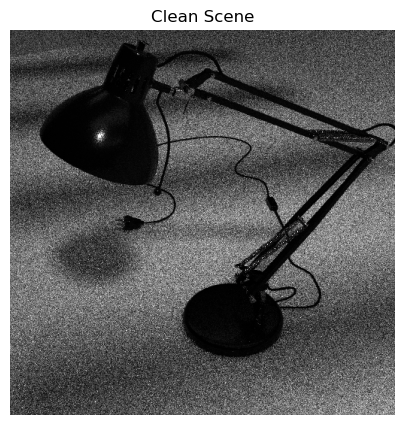

RGB at (256, 256): [0.456564, 0.456564, 0.456564]


In [19]:
# Load scene
scene = load_scene_xml('data/lamp')

# Get original sensor
old_sensor = scene.sensors()[0]

params = mi.traverse(old_sensor)

old_film = old_sensor.film()
near_clip = old_sensor.near_clip()
far_clip = old_sensor.far_clip()
to_world_scalar = old_sensor.world_transform()
fov = params['x_fov']
print(fov)

new_sensor_dict = {
    'type': 'perspective',
    'fov': params['x_fov'],
    'to_world': to_world_scalar,
    'near_clip': near_clip,
    'far_clip': far_clip,
    'film': {
        'type': 'hdrfilm',
        'width': WIDTH,
        'height': HEIGHT,
        'rfilter': {'type': 'box'},
    },
    'sampler': {
        'type': 'independent',
        'sample_count': 1,
    }
}

new_sensor = mi.load_dict(new_sensor_dict)

# Render
seed = 27
noisy_img = mi.render(scene, seed=seed, sensor=new_sensor, spp=10)
print("Noisy Image Shape: ", noisy_img.shape)

plt.figure(figsize=(12,5))
plt.title("Clean Scene")
plt.imshow(np.clip(noisy_img, 0, 1))
plt.axis('off')
plt.show()

# Choose a pixel, e.g. center pixel
H, W = noisy_img.shape[:2]
x, y = W // 2, H // 2

# Print RGB at that pixel
print(f"RGB at ({y}, {x}):", noisy_img[y, x])

In [20]:
# Single Image (Test)
# single_hist = scene_processing_pipeline(one_scene, gen_clean=True)
# save_tiff(single_hist, "single-data", OUTPUT_DIR)

In [21]:
# print(single_hist.shape)

# Select a specific pixel (i, j) and channel (c)
i, j, c = 128, 128, 1           # Middle pixel, first channel (B)
# single_hist[0, i, j, c, :]    # Shape: (num_bins + 1,)

In [22]:
# single_hist[0, i, j, 2, :]

# TRAIN & TEST SCENE GENERATION

- TRAIN: CPU + 11 scenes + 700 x 1000 + gen_clean=False --> 50 min
- TEST: CPU + 3 scenes + 700 x 1000 + gen_clean(150)=False --> 59 min

  0%|          | 0/21 [00:00<?, ?it/s]


Processing scene 1 of 21: data/spaceship

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [7.9539e-06, 6.3015e-01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 139791/786432 (17.78%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


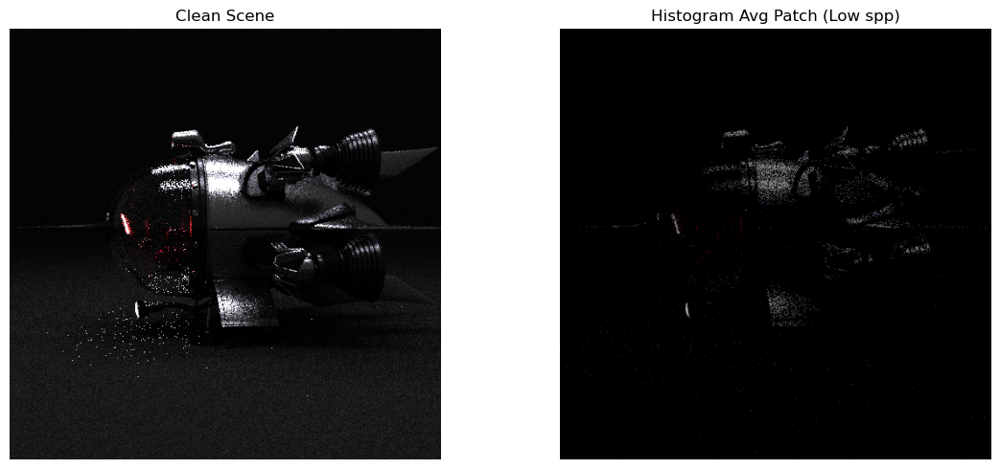

  5%|▍         | 1/21 [00:33<11:07, 33.35s/it]


Processing scene 2 of 21: data/staircase2

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [8.0136e-07, 4.5750e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 338616/786432 (43.06%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


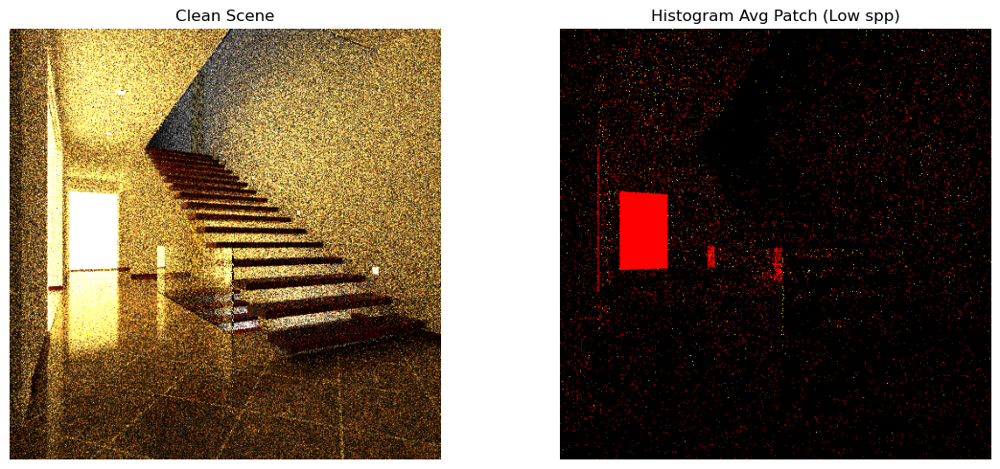

 10%|▉         | 2/21 [00:55<08:24, 26.53s/it]


Processing scene 3 of 21: data/volumetric-caustic

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [2.0982e-03, 1.2272e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 286887/786432 (36.48%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


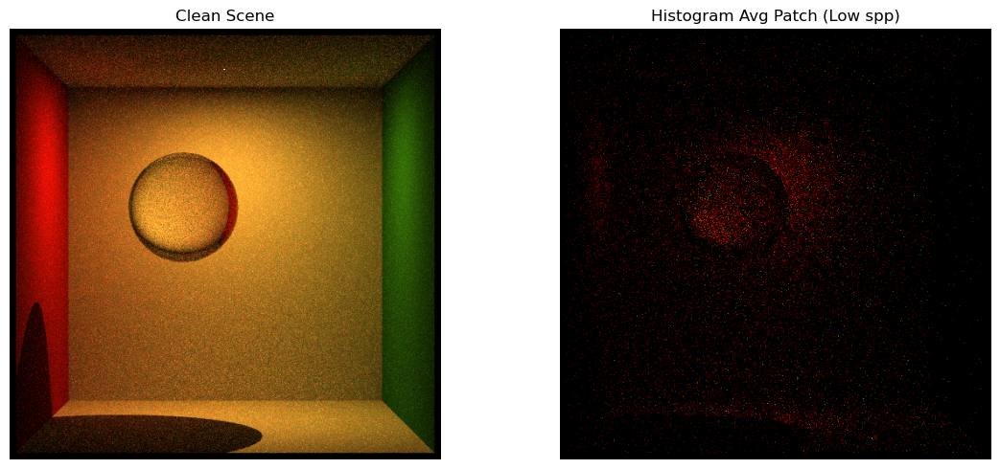

 14%|█▍        | 3/21 [01:11<06:35, 21.99s/it]


Processing scene 4 of 21: data/living-room-2

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [8.0154e-05, 1.7777e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 214900/786432 (27.33%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


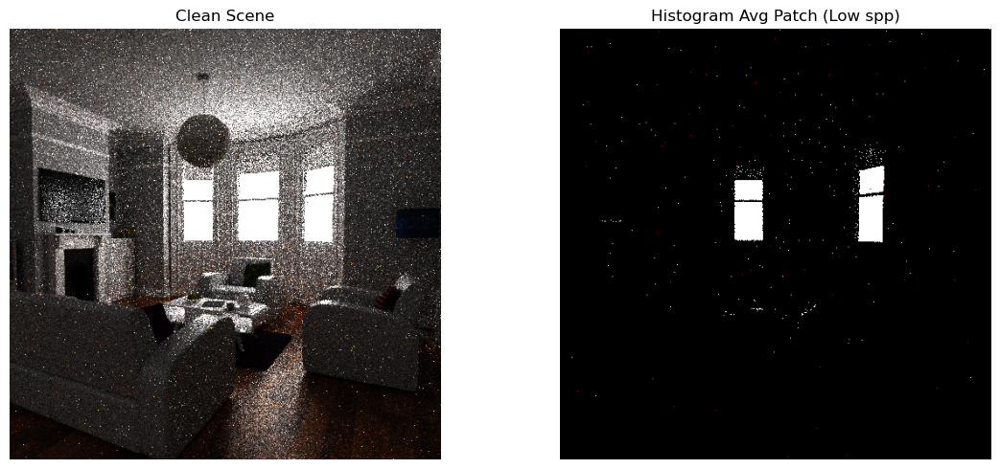

 19%|█▉        | 4/21 [01:36<06:31, 23.03s/it]


Processing scene 5 of 21: data/classroom

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [1.0930e-03, 3.7847e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 1558964/786432 (198.23%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


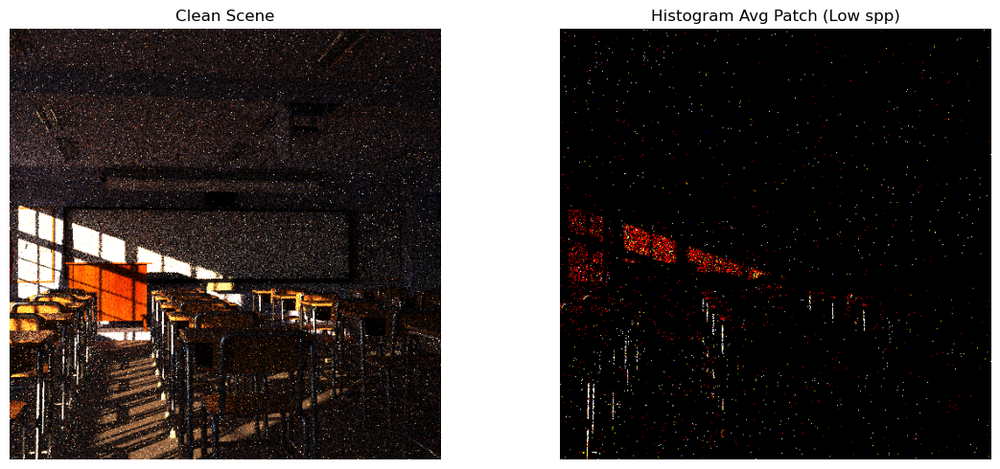

 24%|██▍       | 5/21 [01:59<06:10, 23.16s/it]


Processing scene 6 of 21: data/matpreview

--- Camera/View: scene-above ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.1132e-03, 2.2249e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 46356/786432 (5.89%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


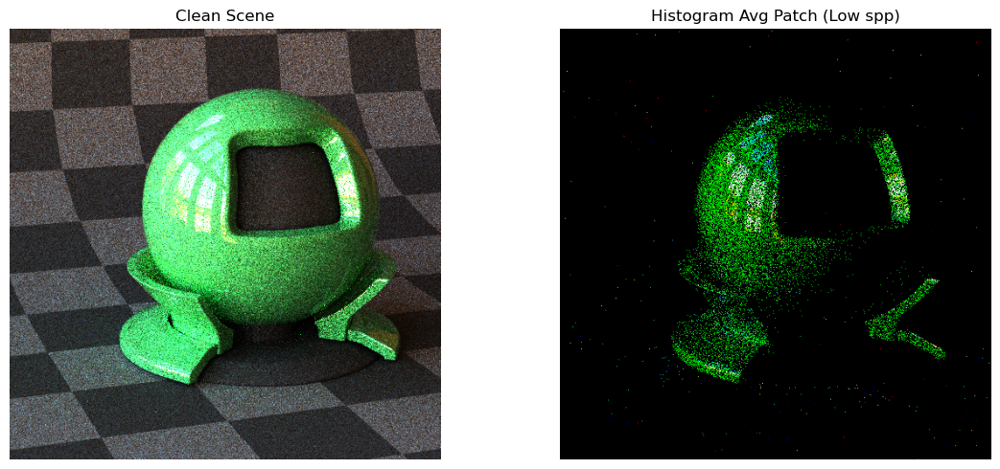


--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.0168e-03, 3.0794e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 73248/786432 (9.31%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


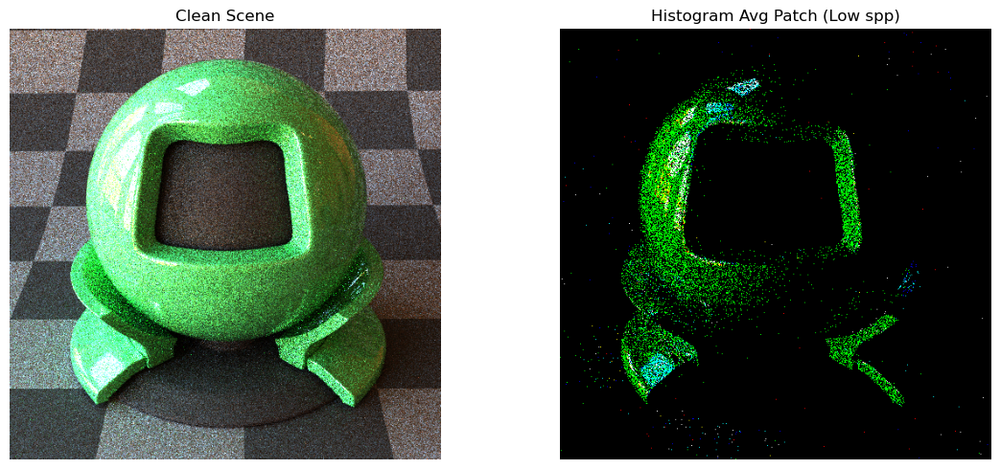

 29%|██▊       | 6/21 [02:30<06:25, 25.72s/it]


Processing scene 7 of 21: data/living-room

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [9.4816e-05, 7.5649e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 1776330/786432 (225.87%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


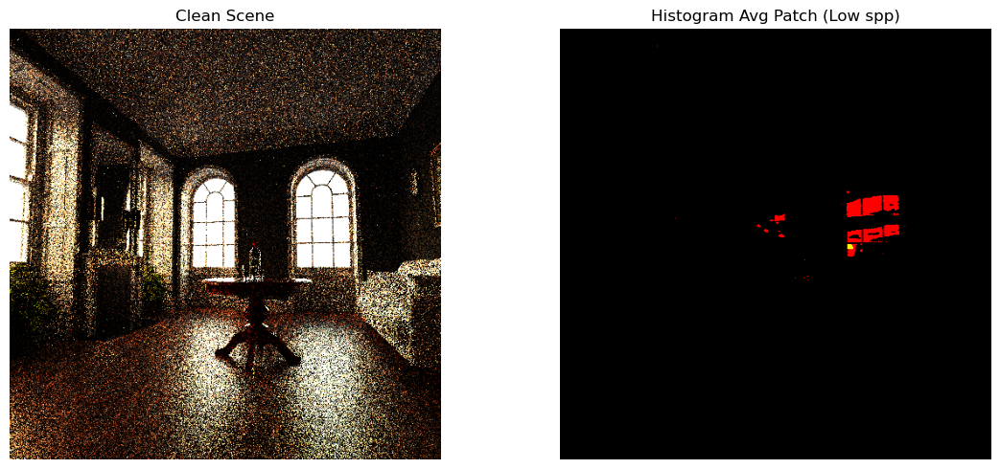

 33%|███▎      | 7/21 [02:55<05:56, 25.46s/it]


Processing scene 8 of 21: data/dining-room

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [5.3591e-05, 2.2380e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 1381648/786432 (175.69%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


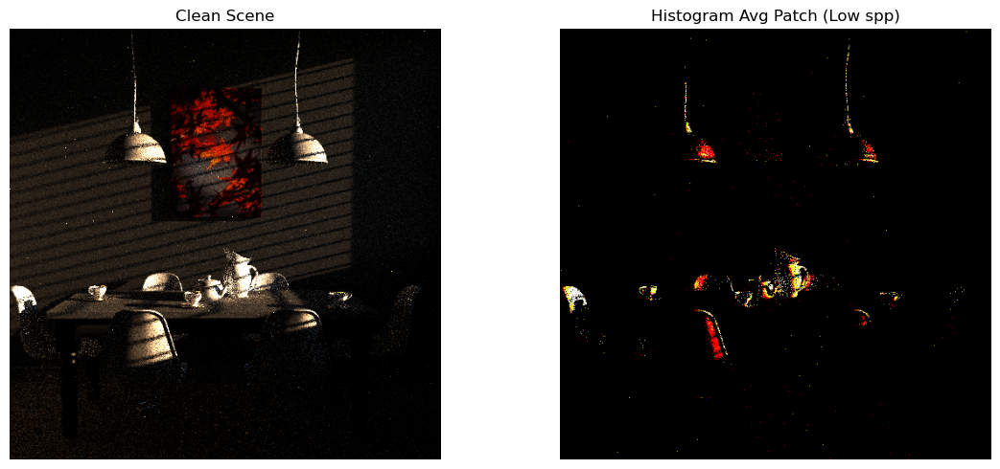

 38%|███▊      | 8/21 [03:18<05:22, 24.84s/it]


Processing scene 9 of 21: data/teapot-full

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [1.1975e-02, 2.8279e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 218128/786432 (27.74%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


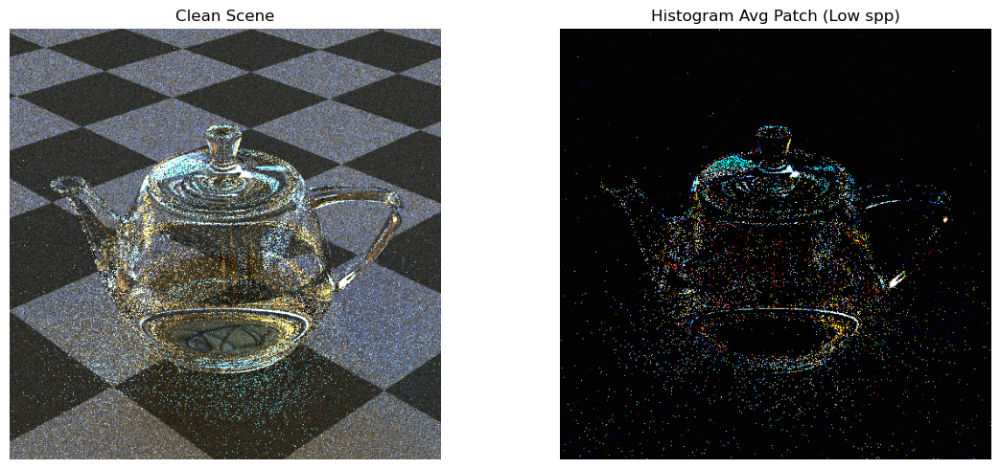

 43%|████▎     | 9/21 [03:35<04:28, 22.39s/it]


Processing scene 10 of 21: data/banner_04

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [1.1104e-02, 4.3804e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 400059/786432 (50.87%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


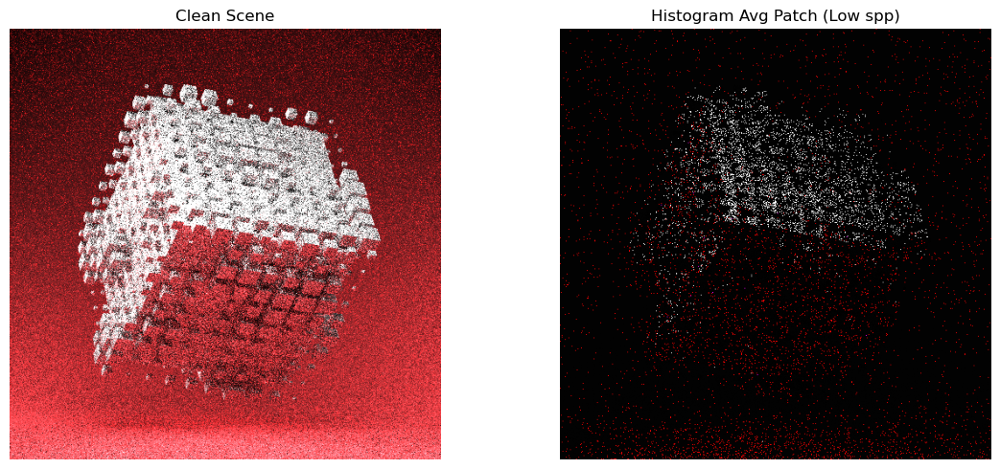

 48%|████▊     | 10/21 [03:52<03:47, 20.66s/it]


Processing scene 11 of 21: data/glass-of-water

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.7511e-03, 2.8331e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 473661/786432 (60.23%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


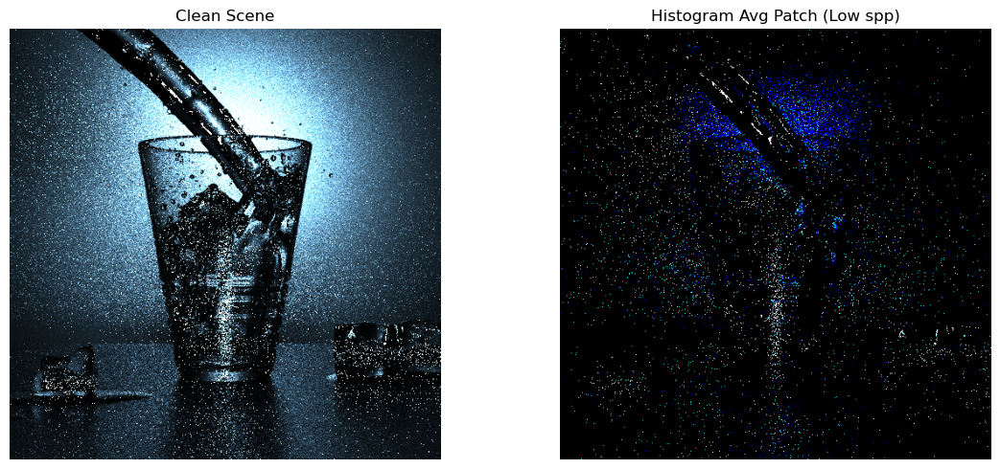

 52%|█████▏    | 11/21 [04:10<03:17, 19.77s/it]


Processing scene 12 of 21: data/bedroom

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [2.2852e-05, 1.6700e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 1838391/786432 (233.76%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


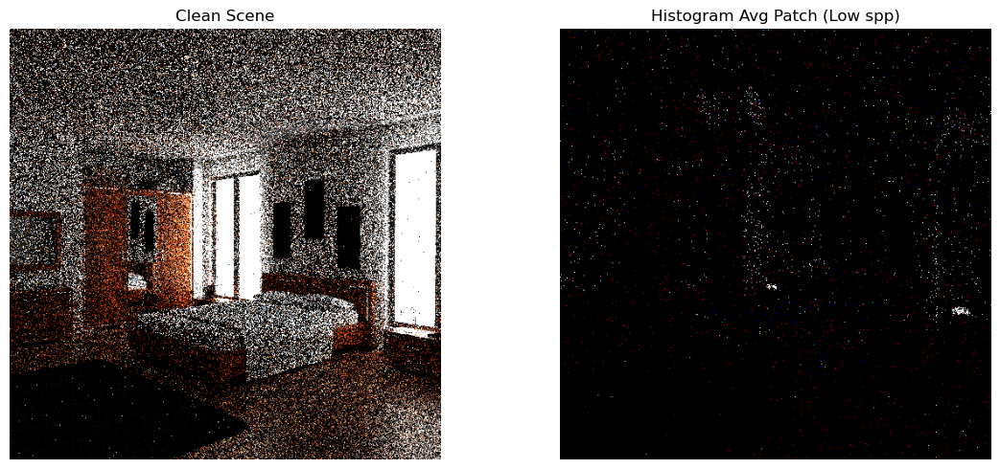

 57%|█████▋    | 12/21 [04:36<03:16, 21.80s/it]


Processing scene 13 of 21: data/lamp

--- Camera/View: scene-above ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [7.7977e-04, 1.5270e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 884838/786432 (112.51%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


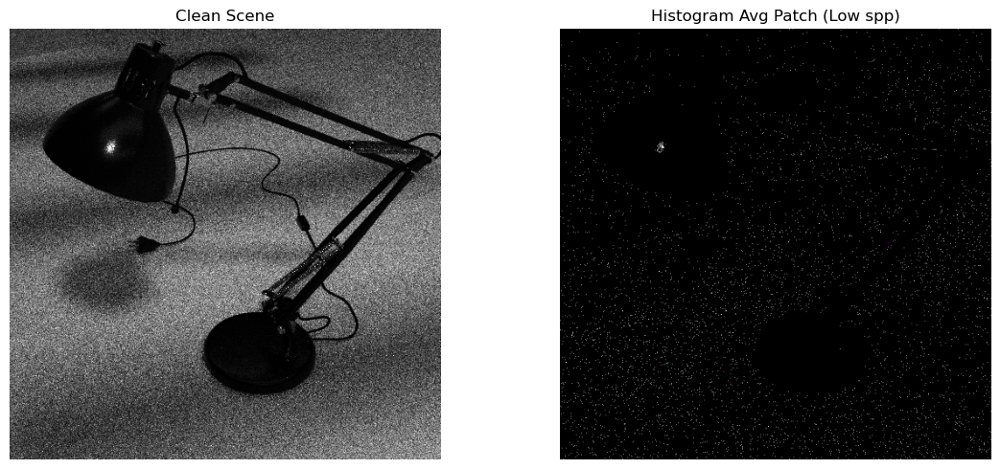


--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [8.9314e-04, 1.9665e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 778872/786432 (99.04%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


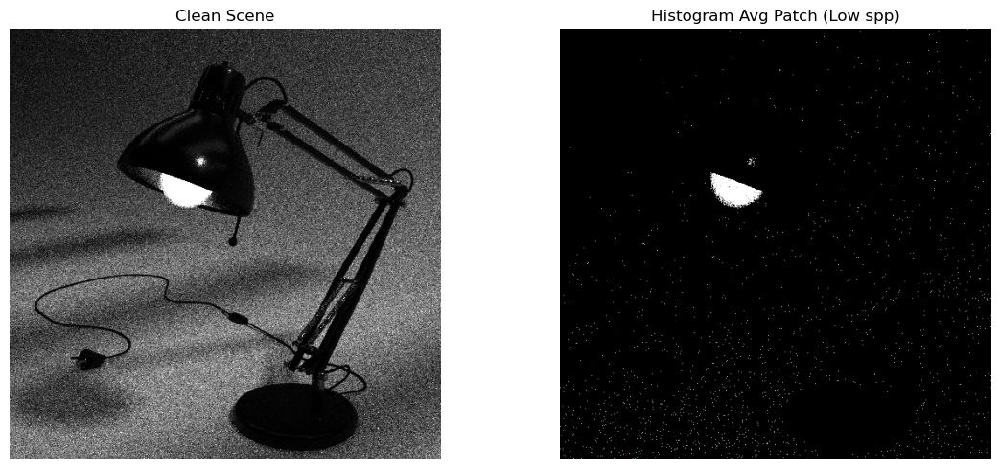

 62%|██████▏   | 13/21 [05:08<03:17, 24.71s/it]


Processing scene 14 of 21: data/cornell-box

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [2.5031e-04, 6.1397e-01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 355401/786432 (45.19%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


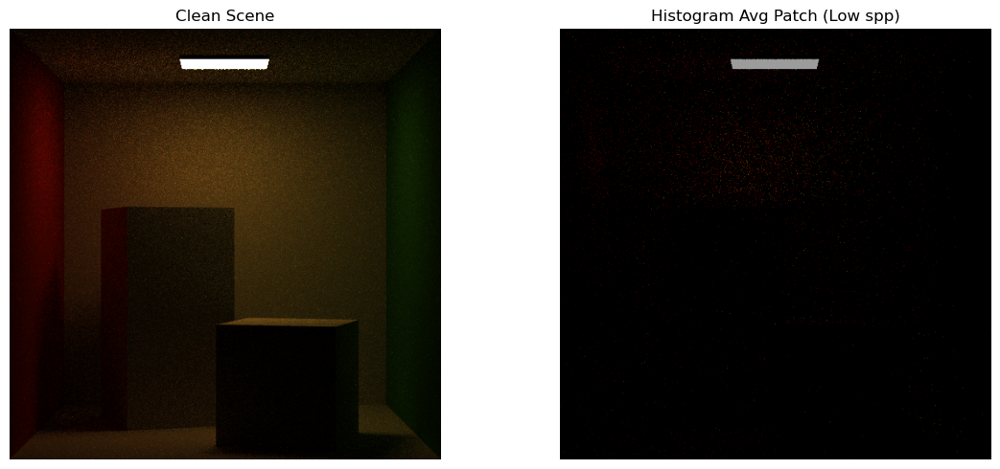

 67%|██████▋   | 14/21 [05:26<02:39, 22.76s/it]


Processing scene 15 of 21: data/veach-mis

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [4.7878e-04, 3.0396e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 498291/786432 (63.36%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


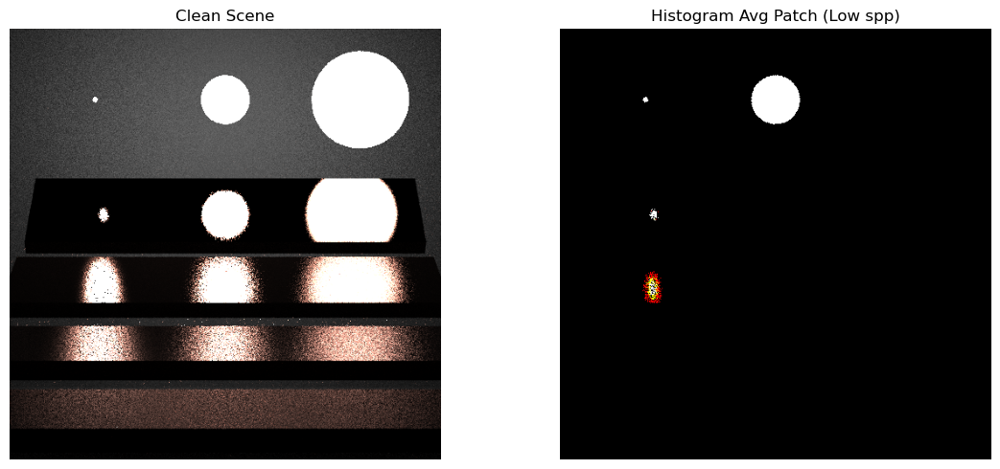

 71%|███████▏  | 15/21 [05:44<02:08, 21.42s/it]


Processing scene 16 of 21: data/kitchen

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [8.9416e-07, 1.6032e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 933375/786432 (118.68%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


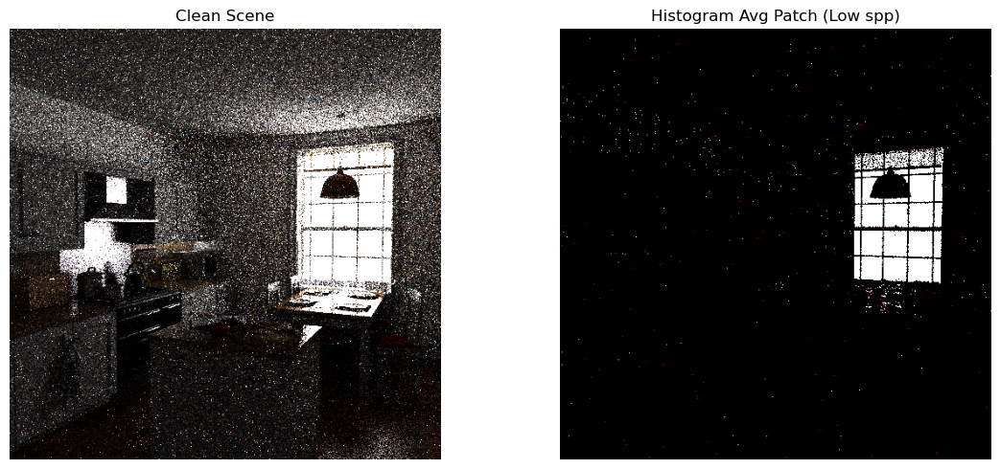

 76%|███████▌  | 16/21 [06:16<02:02, 24.54s/it]


Processing scene 17 of 21: data/living-room-3

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [2.4509e-04, 3.6628e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 87135/786432 (11.08%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


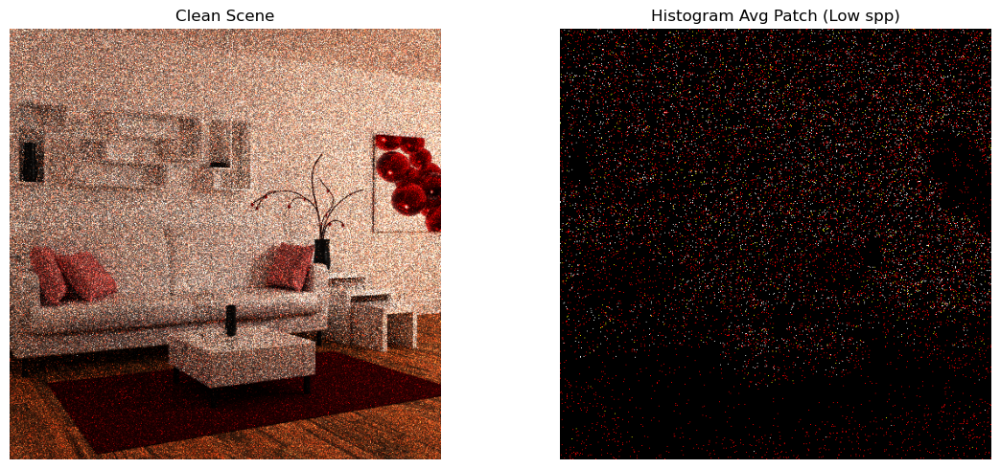

 81%|████████  | 17/21 [06:50<01:49, 27.40s/it]


Processing scene 18 of 21: data/banner_05

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [4.9187e-02, 1.1311e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 196584/786432 (25.00%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


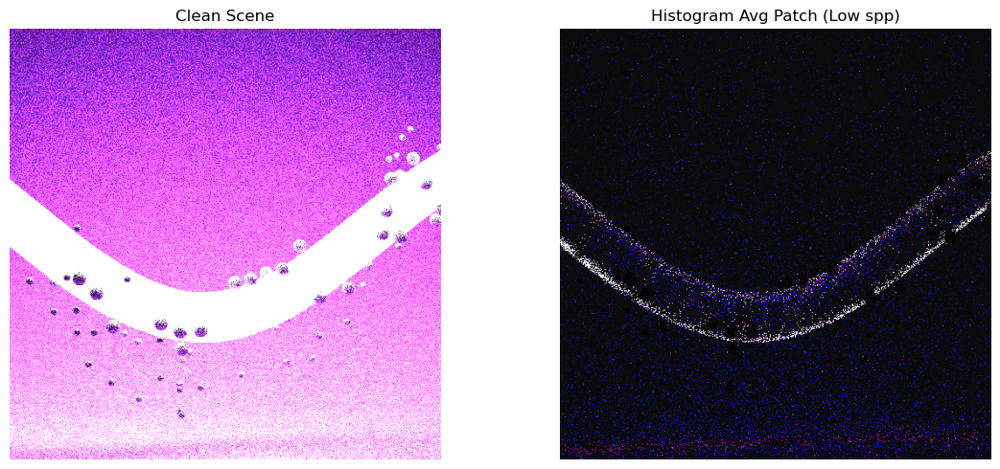

 86%|████████▌ | 18/21 [07:07<01:12, 24.23s/it]


Processing scene 19 of 21: data/banner_01

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [7.5515e-03, 1.8091e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 39024/786432 (4.96%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


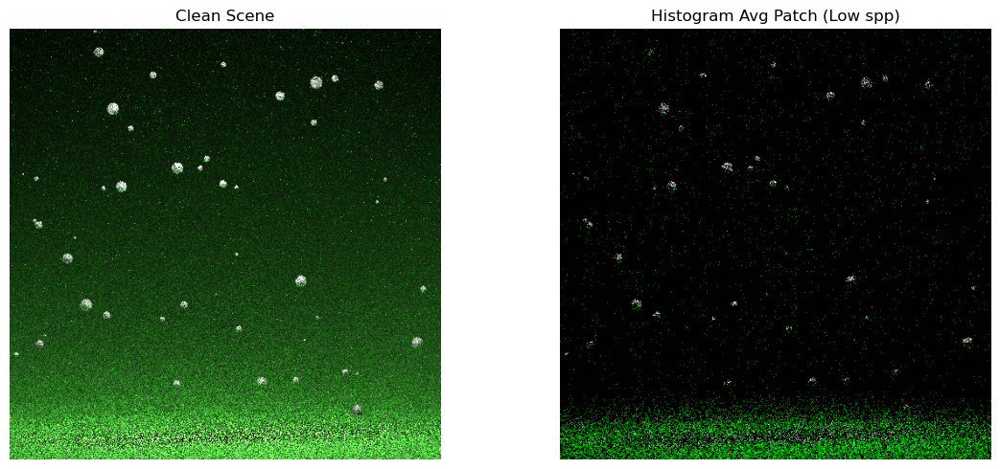

 90%|█████████ | 19/21 [07:23<00:43, 21.88s/it]


Processing scene 20 of 21: data/veach-bidir

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [5.0337e-03, 1.1084e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 1670736/786432 (212.45%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


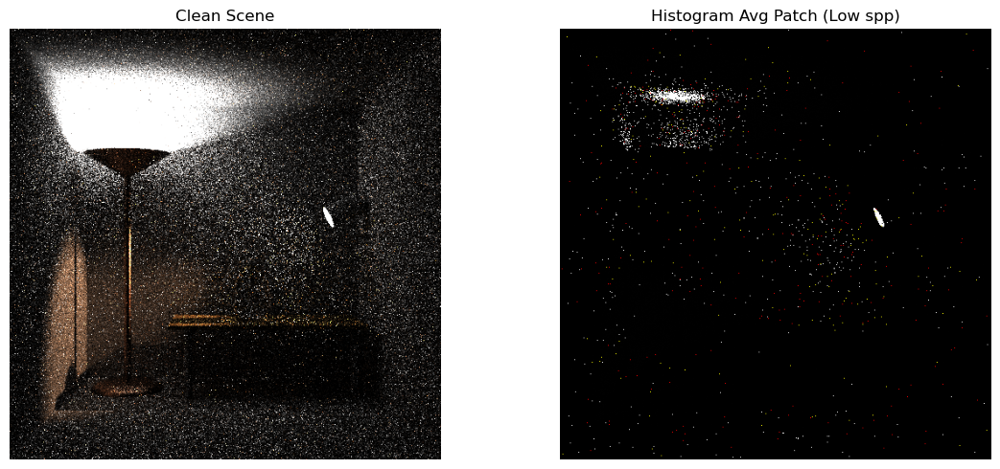

 95%|█████████▌| 20/21 [07:42<00:20, 20.87s/it]


Processing scene 21 of 21: data/veach-ajar

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [7.5526e-03, 9.7722e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 2135725/786432 (271.57%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


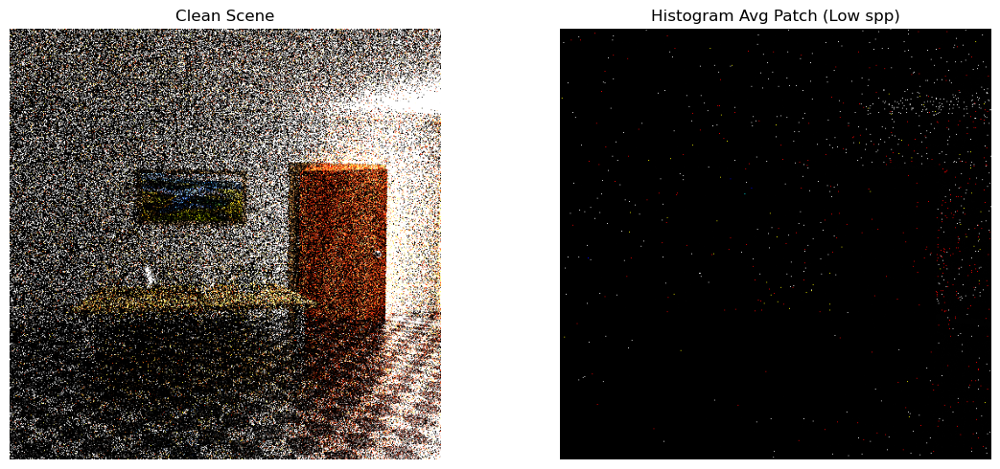

100%|██████████| 21/21 [08:02<00:00, 22.98s/it]


In [23]:
# Train Scenes
train_hist = scene_processing_pipeline(train_scenes, gen_clean=True)
# save_tiff(train_hist, "train-data", OUTPUT_DIR)

In [24]:
import gc
del train_hist

gc.collect()

56995

  0%|          | 0/6 [00:00<?, ?it/s]


Processing scene 1 of 6: data/banner_07

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [4.5566e-07, 2.3902e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 233961/786432 (29.75%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


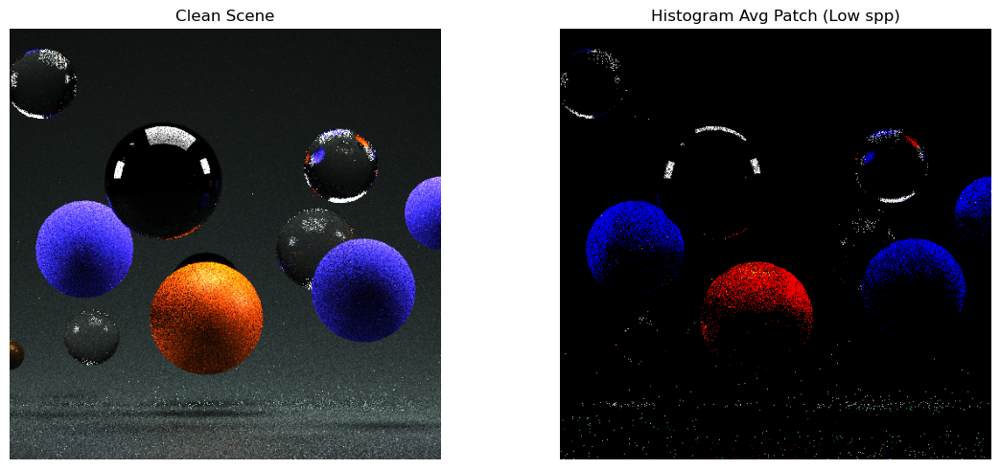

 17%|█▋        | 1/6 [00:16<01:22, 16.45s/it]


Processing scene 2 of 6: data/bathroom

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [2.5351e-05, 3.0000e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 1285203/786432 (163.42%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


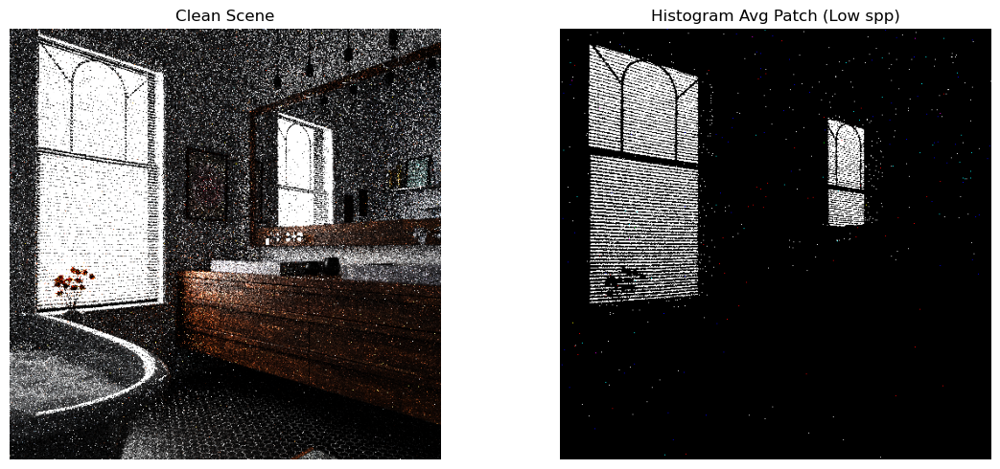

 33%|███▎      | 2/6 [00:40<01:23, 20.88s/it]


Processing scene 3 of 6: data/bathroom2

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.4467e-04, 1.2500e+02]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 196416/786432 (24.98%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


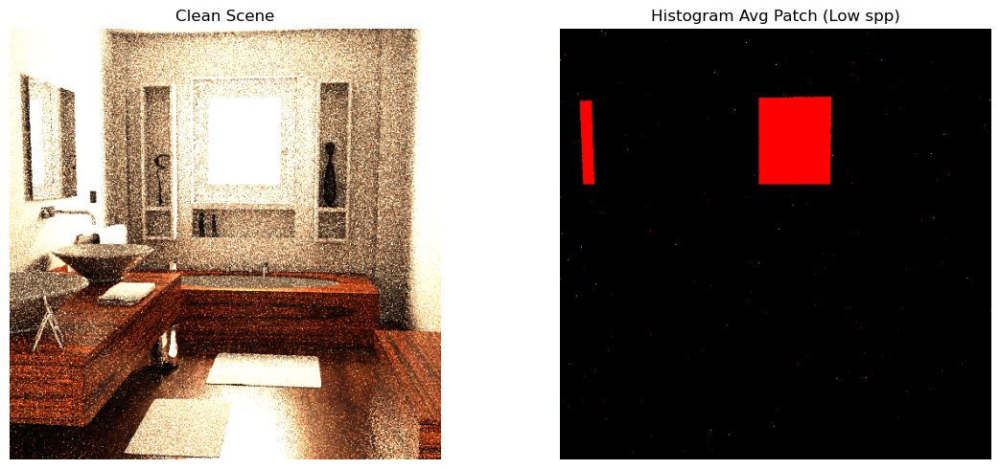

 50%|█████     | 3/6 [01:02<01:04, 21.50s/it]


Processing scene 4 of 6: data/banner_02

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [1.5352e-03, 4.1921e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 353442/786432 (44.94%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


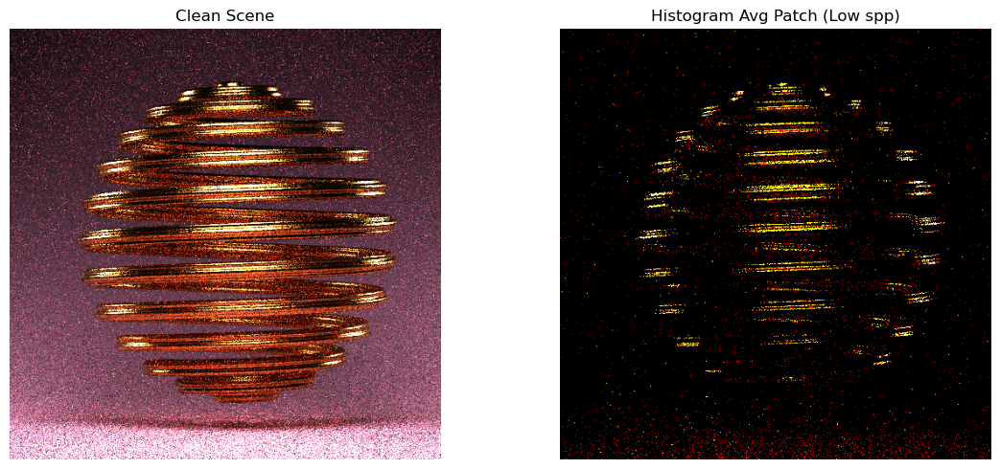

 67%|██████▋   | 4/6 [01:21<00:41, 20.58s/it]


Processing scene 5 of 6: data/staircase

--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.3956e-05, 1.7570e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 548921/786432 (69.80%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


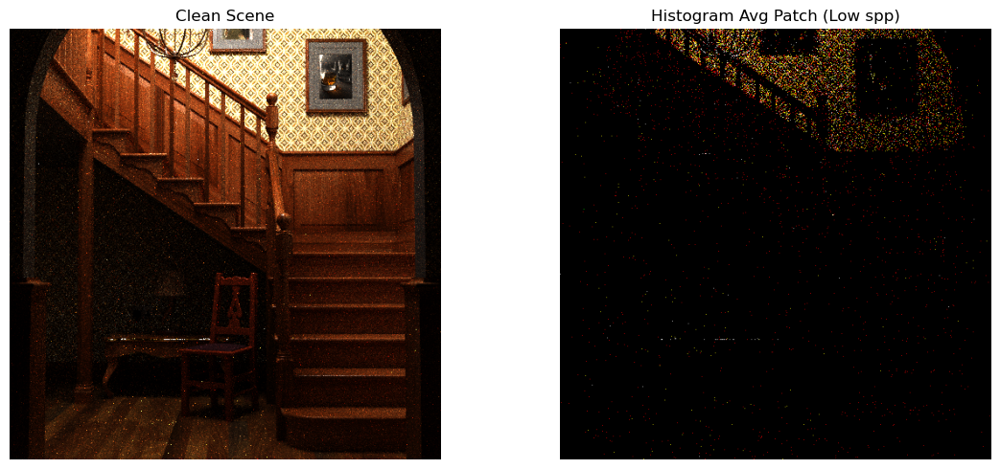

 83%|████████▎ | 5/6 [01:48<00:22, 22.78s/it]


Processing scene 6 of 6: data/house

--- Camera/View: scene-above ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [4.7418e-04, 1.1866e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 318819/786432 (40.54%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


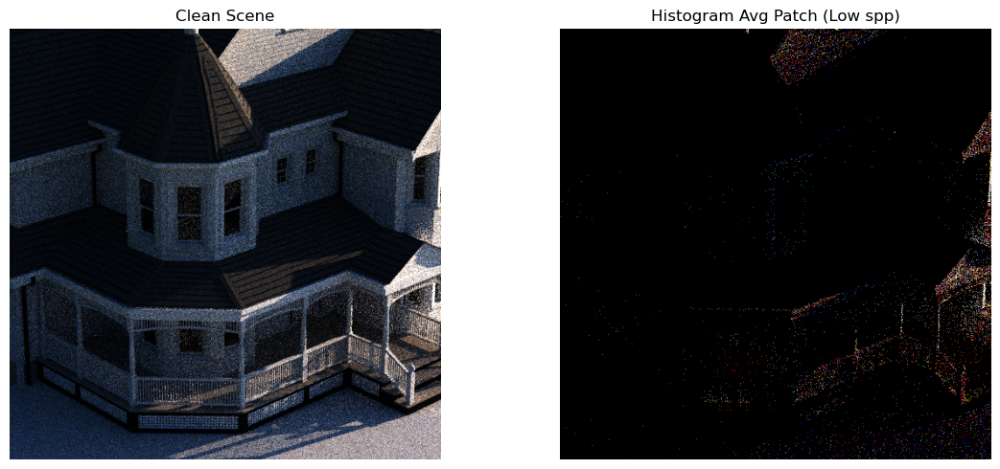


--- Camera/View: scene ---
Range Val: 2
SPP: 5
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.8110e-04, 1.1259e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 3, 3)
Accumulating Histogram >.<
Zero samples: 541083/786432 (68.80%)
Rendering clean reference...
Average Histogram Shape:  (512, 512, 3)
Clean Image:  (512, 512, 3)
Average from Histogram:  (512, 512, 3)


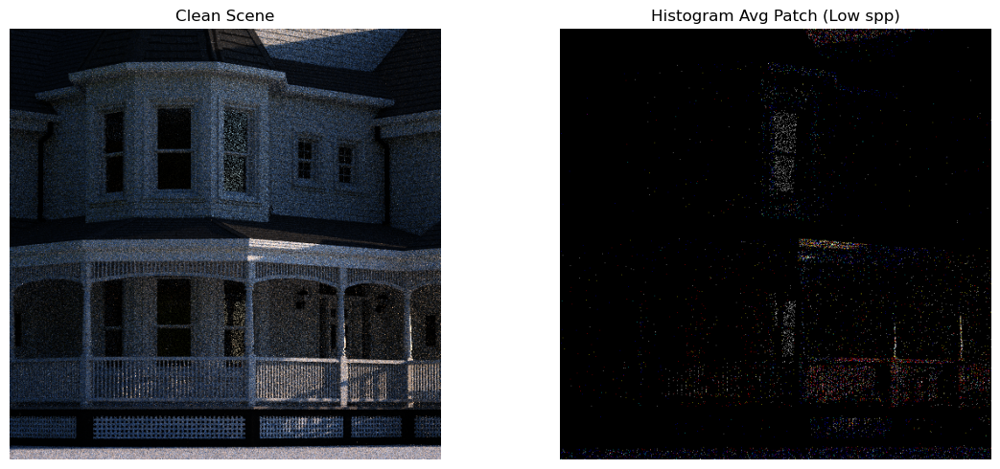

100%|██████████| 6/6 [02:43<00:00, 27.21s/it]


In [25]:
# Test Scenes
test_hist = scene_processing_pipeline(test_scenes, gen_clean=True)
# save_tiff(test_hist, "test-data", OUTPUT_DIR)

  0%|          | 0/6 [00:00<?, ?it/s]


Processing scene 1 of 6: data/banner_07

--- Camera/View: scene ---
Range Val: 2
SPP: 50
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [4.5566e-07, 2.3902e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Iteration 5 :)
Iteration 6 :)
Iteration 7 :)
Iteration 8 :)
Iteration 9 :)
Iteration 10 :)
Iteration 11 :)
Iteration 12 :)
Iteration 13 :)
Iteration 14 :)
Iteration 15 :)
Iteration 16 :)
Iteration 17 :)
Iteration 18 :)
Iteration 19 :)
Iteration 20 :)
Iteration 21 :)
Iteration 22 :)
Iteration 23 :)
Iteration 24 :)
Iteration 25 :)
Iteration 26 :)
Iteration 27 :)
Iteration 28 :)
Iteration 29 :)
Iteration 30 :)
Iteration 31 :)
Iteration 32 :)
Iteration 33 :)
Iteration 34 :)
Iteration 35 :)
Iteration 36 :)
Iteration 37 :)
Iteration 38 :)
Iteration 39 :)
Iteration 40 :)
Iteration 41 :)
Iteration 42 :)
Iteration 43 :)
Iteration 44 :)
Iteration 45 :)
Iteration 46 :)
Iteration 47 :)
Iteration 48 :)
Iteration 49 :)
Image Samples Shape: (512, 512, 3)
Stacke

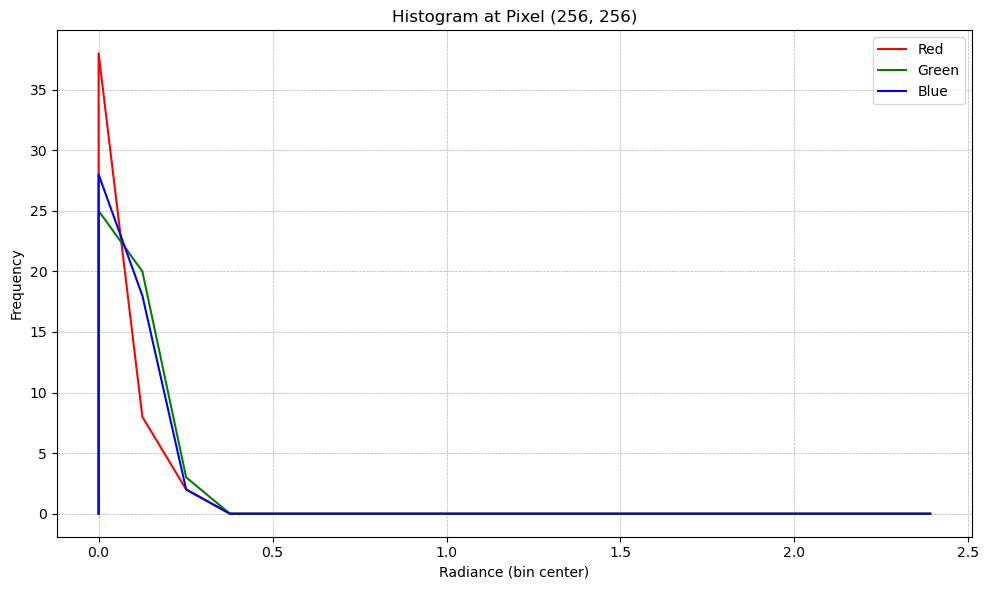

 17%|█▋        | 1/6 [00:35<02:56, 35.38s/it]


Processing scene 2 of 6: data/bathroom

--- Camera/View: scene ---
Range Val: 2
SPP: 50
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [2.5351e-05, 3.0000e+01]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Iteration 5 :)
Iteration 6 :)
Iteration 7 :)
Iteration 8 :)
Iteration 9 :)
Iteration 10 :)
Iteration 11 :)
Iteration 12 :)
Iteration 13 :)
Iteration 14 :)
Iteration 15 :)
Iteration 16 :)
Iteration 17 :)
Iteration 18 :)
Iteration 19 :)
Iteration 20 :)
Iteration 21 :)
Iteration 22 :)
Iteration 23 :)
Iteration 24 :)
Iteration 25 :)
Iteration 26 :)
Iteration 27 :)
Iteration 28 :)
Iteration 29 :)
Iteration 30 :)
Iteration 31 :)
Iteration 32 :)
Iteration 33 :)
Iteration 34 :)
Iteration 35 :)
Iteration 36 :)
Iteration 37 :)
Iteration 38 :)
Iteration 39 :)
Iteration 40 :)
Iteration 41 :)
Iteration 42 :)
Iteration 43 :)
Iteration 44 :)
Iteration 45 :)
Iteration 46 :)
Iteration 47 :)
Iteration 48 :)
Iteration 49 :)
Image Samples Shape: (512, 512, 3)
Stacked

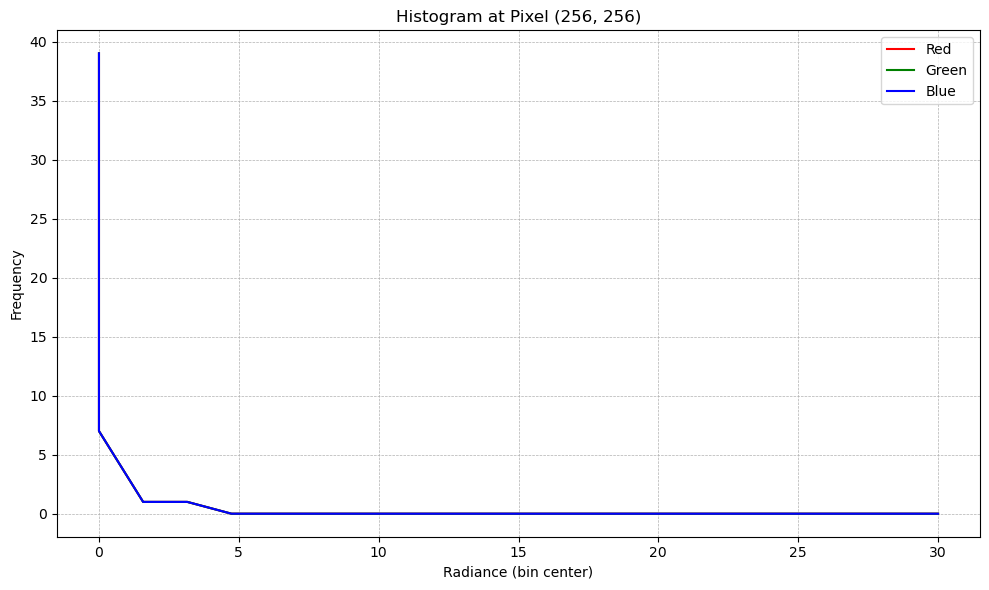

 33%|███▎      | 2/6 [01:48<03:51, 57.85s/it]


Processing scene 3 of 6: data/bathroom2

--- Camera/View: scene ---
Range Val: 2
SPP: 50
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.4467e-04, 1.2500e+02]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Iteration 5 :)
Iteration 6 :)
Iteration 7 :)
Iteration 8 :)
Iteration 9 :)
Iteration 10 :)
Iteration 11 :)
Iteration 12 :)
Iteration 13 :)
Iteration 14 :)
Iteration 15 :)
Iteration 16 :)
Iteration 17 :)
Iteration 18 :)
Iteration 19 :)
Iteration 20 :)
Iteration 21 :)
Iteration 22 :)
Iteration 23 :)
Iteration 24 :)
Iteration 25 :)
Iteration 26 :)
Iteration 27 :)
Iteration 28 :)
Iteration 29 :)
Iteration 30 :)
Iteration 31 :)
Iteration 32 :)
Iteration 33 :)
Iteration 34 :)
Iteration 35 :)
Iteration 36 :)
Iteration 37 :)
Iteration 38 :)
Iteration 39 :)
Iteration 40 :)
Iteration 41 :)
Iteration 42 :)
Iteration 43 :)
Iteration 44 :)
Iteration 45 :)
Iteration 46 :)
Iteration 47 :)
Iteration 48 :)
Iteration 49 :)
Image Samples Shape: (512, 512, 3)
Stacke

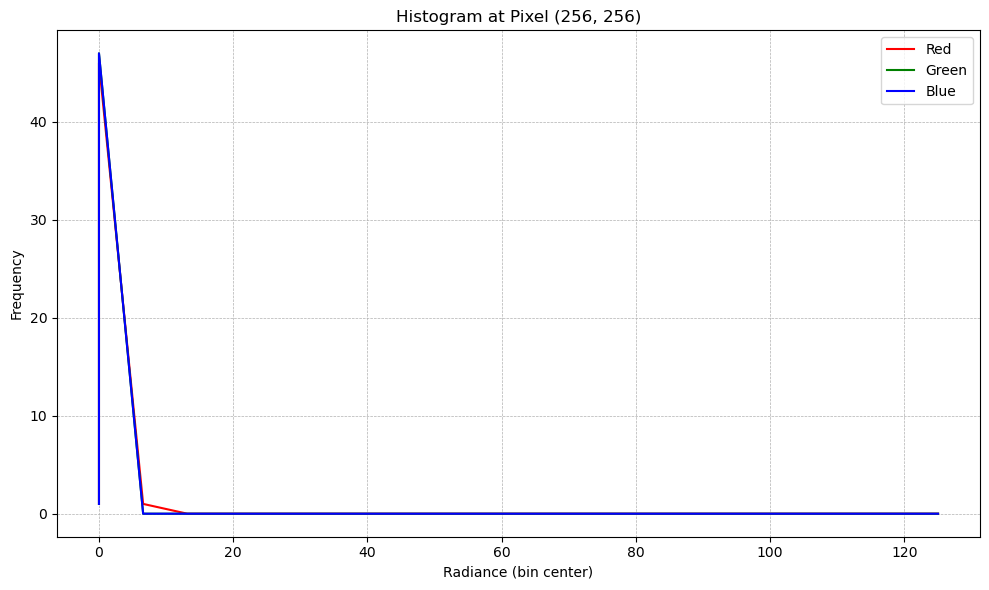

 50%|█████     | 3/6 [02:41<02:45, 55.22s/it]


Processing scene 4 of 6: data/banner_02

--- Camera/View: scene ---
Range Val: 2
SPP: 50
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [1.5352e-03, 4.1921e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Iteration 5 :)
Iteration 6 :)
Iteration 7 :)
Iteration 8 :)
Iteration 9 :)
Iteration 10 :)
Iteration 11 :)
Iteration 12 :)
Iteration 13 :)
Iteration 14 :)
Iteration 15 :)
Iteration 16 :)
Iteration 17 :)
Iteration 18 :)
Iteration 19 :)
Iteration 20 :)
Iteration 21 :)
Iteration 22 :)
Iteration 23 :)
Iteration 24 :)
Iteration 25 :)
Iteration 26 :)
Iteration 27 :)
Iteration 28 :)
Iteration 29 :)
Iteration 30 :)
Iteration 31 :)
Iteration 32 :)
Iteration 33 :)
Iteration 34 :)
Iteration 35 :)
Iteration 36 :)
Iteration 37 :)
Iteration 38 :)
Iteration 39 :)
Iteration 40 :)
Iteration 41 :)
Iteration 42 :)
Iteration 43 :)
Iteration 44 :)
Iteration 45 :)
Iteration 46 :)
Iteration 47 :)
Iteration 48 :)
Iteration 49 :)
Image Samples Shape: (512, 512, 3)
Stacke

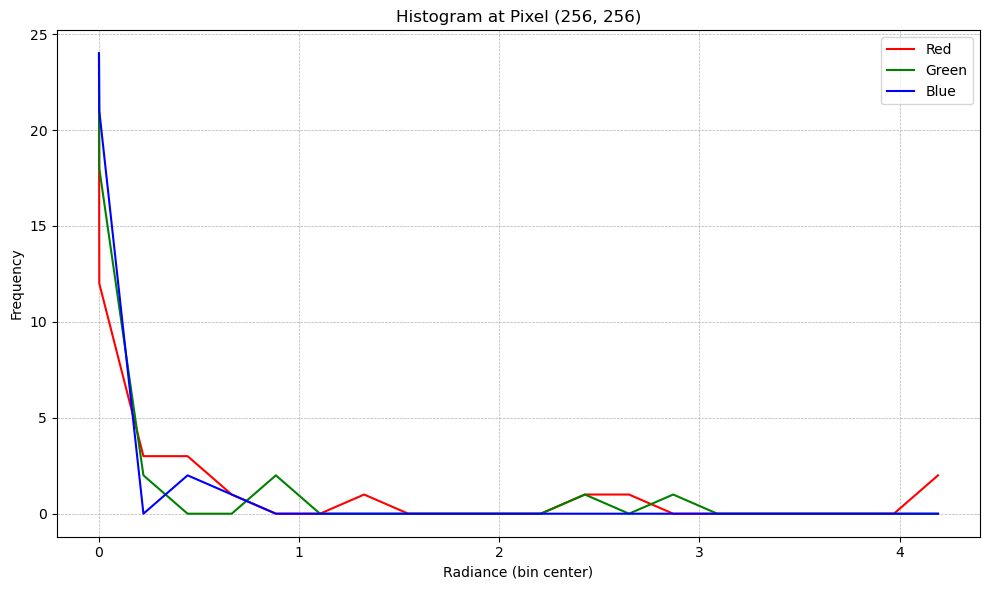

 67%|██████▋   | 4/6 [03:13<01:32, 46.22s/it]


Processing scene 5 of 6: data/staircase

--- Camera/View: scene ---
Range Val: 2
SPP: 50
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.3956e-05, 1.7570e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Iteration 5 :)
Iteration 6 :)
Iteration 7 :)
Iteration 8 :)
Iteration 9 :)
Iteration 10 :)
Iteration 11 :)
Iteration 12 :)
Iteration 13 :)
Iteration 14 :)
Iteration 15 :)
Iteration 16 :)
Iteration 17 :)
Iteration 18 :)
Iteration 19 :)
Iteration 20 :)
Iteration 21 :)
Iteration 22 :)
Iteration 23 :)
Iteration 24 :)
Iteration 25 :)
Iteration 26 :)
Iteration 27 :)
Iteration 28 :)
Iteration 29 :)
Iteration 30 :)
Iteration 31 :)
Iteration 32 :)
Iteration 33 :)
Iteration 34 :)
Iteration 35 :)
Iteration 36 :)
Iteration 37 :)
Iteration 38 :)
Iteration 39 :)
Iteration 40 :)
Iteration 41 :)
Iteration 42 :)
Iteration 43 :)
Iteration 44 :)
Iteration 45 :)
Iteration 46 :)
Iteration 47 :)
Iteration 48 :)
Iteration 49 :)
Image Samples Shape: (512, 512, 3)
Stacke

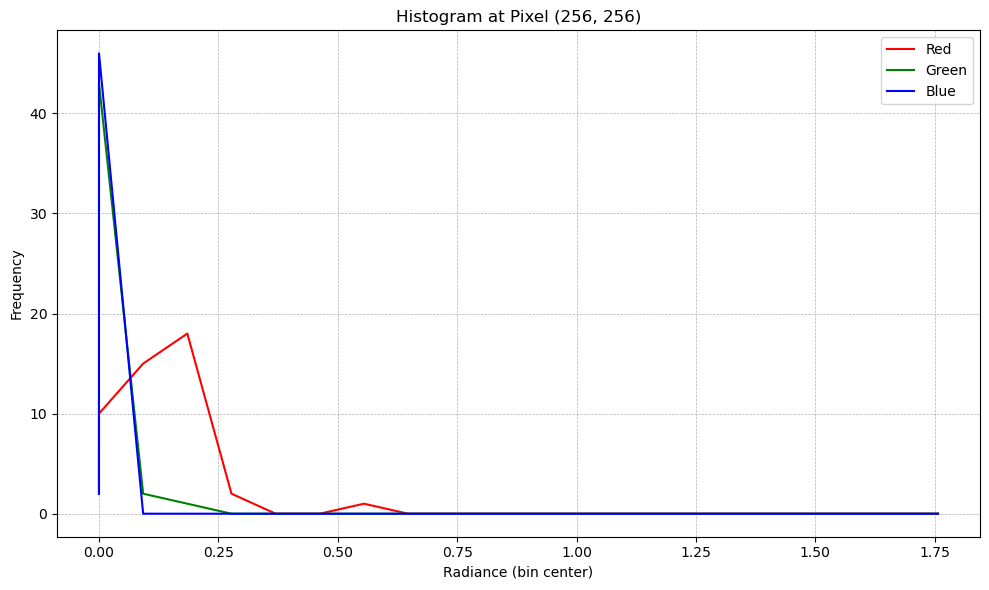

 83%|████████▎ | 5/6 [04:19<00:53, 53.20s/it]


Processing scene 6 of 6: data/house

--- Camera/View: scene-above ---
Range Val: 2
SPP: 50
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [4.7418e-04, 1.1866e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Iteration 5 :)
Iteration 6 :)
Iteration 7 :)
Iteration 8 :)
Iteration 9 :)
Iteration 10 :)
Iteration 11 :)
Iteration 12 :)
Iteration 13 :)
Iteration 14 :)
Iteration 15 :)
Iteration 16 :)
Iteration 17 :)
Iteration 18 :)
Iteration 19 :)
Iteration 20 :)
Iteration 21 :)
Iteration 22 :)
Iteration 23 :)
Iteration 24 :)
Iteration 25 :)
Iteration 26 :)
Iteration 27 :)
Iteration 28 :)
Iteration 29 :)
Iteration 30 :)
Iteration 31 :)
Iteration 32 :)
Iteration 33 :)
Iteration 34 :)
Iteration 35 :)
Iteration 36 :)
Iteration 37 :)
Iteration 38 :)
Iteration 39 :)
Iteration 40 :)
Iteration 41 :)
Iteration 42 :)
Iteration 43 :)
Iteration 44 :)
Iteration 45 :)
Iteration 46 :)
Iteration 47 :)
Iteration 48 :)
Iteration 49 :)
Image Samples Shape: (512, 512, 3)
Stac

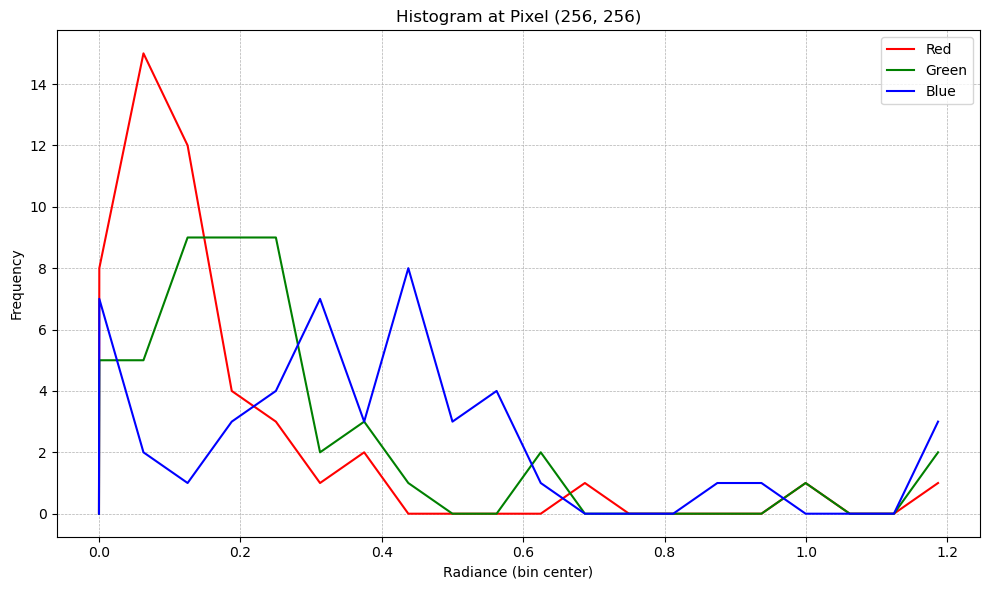


--- Camera/View: scene ---
Range Val: 2
SPP: 50
Total Pixels: 262144
Iteration 0 <3
Iteration 1 <3
Linear estimated radiance range: [3.8110e-04, 1.1259e+00]
Iteration 2 :)
Iteration 3 :)
Iteration 4 :)
Iteration 5 :)
Iteration 6 :)
Iteration 7 :)
Iteration 8 :)
Iteration 9 :)
Iteration 10 :)
Iteration 11 :)
Iteration 12 :)
Iteration 13 :)
Iteration 14 :)
Iteration 15 :)
Iteration 16 :)
Iteration 17 :)
Iteration 18 :)
Iteration 19 :)
Iteration 20 :)
Iteration 21 :)
Iteration 22 :)
Iteration 23 :)
Iteration 24 :)
Iteration 25 :)
Iteration 26 :)
Iteration 27 :)
Iteration 28 :)
Iteration 29 :)
Iteration 30 :)
Iteration 31 :)
Iteration 32 :)
Iteration 33 :)
Iteration 34 :)
Iteration 35 :)
Iteration 36 :)
Iteration 37 :)
Iteration 38 :)
Iteration 39 :)
Iteration 40 :)
Iteration 41 :)
Iteration 42 :)
Iteration 43 :)
Iteration 44 :)
Iteration 45 :)
Iteration 46 :)
Iteration 47 :)
Iteration 48 :)
Iteration 49 :)
Image Samples Shape: (512, 512, 3)
Stacked Samples Shape: (512, 512, 48, 3)
Accumu

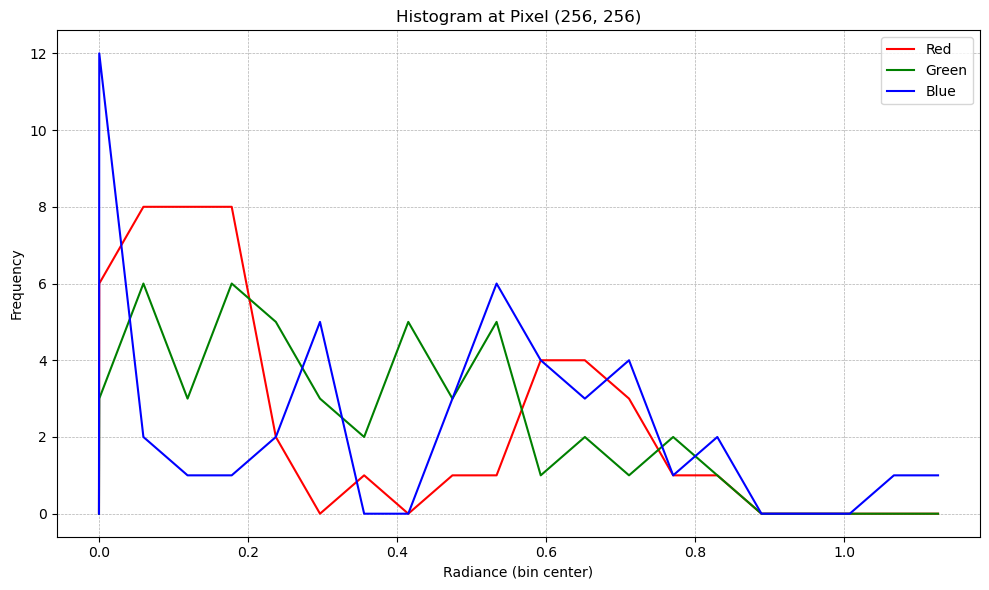

100%|██████████| 6/6 [05:38<00:00, 56.39s/it]


array([[[[[ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0]],

         [[ 0, 48,  0, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0]],

         [[ 0, 48,  0, ...,  0,  0,  0],
          [ 0, 46,  2, ...,  0,  0,  0],
          [ 0, 46,  2, ...,  0,  0,  0]],

         ...,

         [[ 0, 48,  0, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0]],

         [[ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 45,  3, ...,  0,  0,  0],
          [ 0, 45,  3, ...,  0,  0,  0]],

         [[ 0, 46,  1, ...,  0,  0,  0],
          [ 0, 45,  2, ...,  0,  0,  0],
          [ 0, 45,  2, ...,  0,  0,  0]]],


        [[[ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0]],

         [[ 0, 48,  0, ...,  0,  0,  0],
          [ 0, 47,  1, ...,  0,  0,  0],
          [ 0, 47,  1, ...

In [28]:
scene_processing_pipeline(test_scenes, low_spp=50, num_bins=20, gen_clean=False, plot_hist=True)